In [2]:
import json
from PIL import Image
import torch
import numpy as np
import torchvision.transforms as transforms
from tenLoader import normalize
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader
from torch.utils.data import Dataset

In [3]:
data_type = "train"
data_path = f"./2017/{data_type}_video_datas.json"
vidao_datas = json.load(open(data_path, "r"))

In [4]:
def reserve_color(anno_array: np.ndarray, color: list[int]) -> np.ndarray:
    color = np.array(color)
    mask = np.all(anno_array == color, axis=-1)
    return mask
index = 3
video_name = list(vidao_datas.keys())[index]
print(video_name)
video_data = vidao_datas[video_name]
img_paths = video_data["img_paths"]
anno_paths = video_data["anno_paths"]
anno_colors = video_data["anno_colors"]
anno_colors

boxing-fisheye


[[0, 128, 0], [128, 0, 0], [128, 128, 0]]

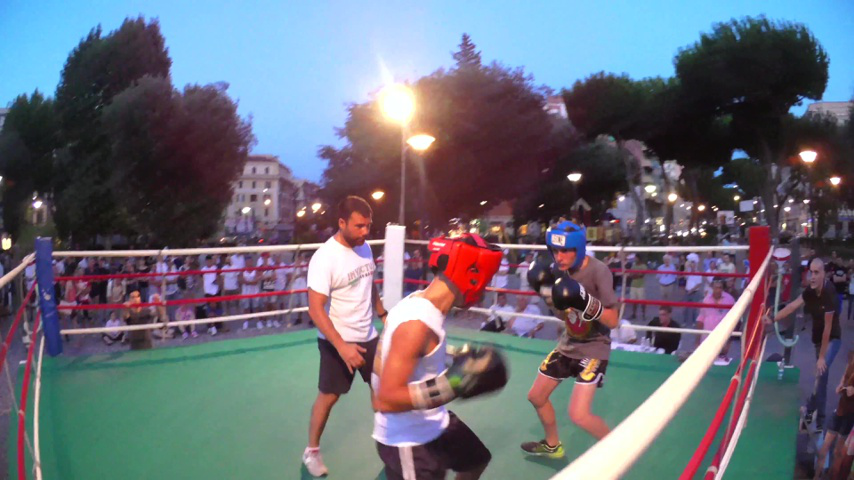

In [5]:
first_img_path = img_paths[0]
Image.open(first_img_path)

In [6]:
img_transforms = transforms.Compose(
    [
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ]
)

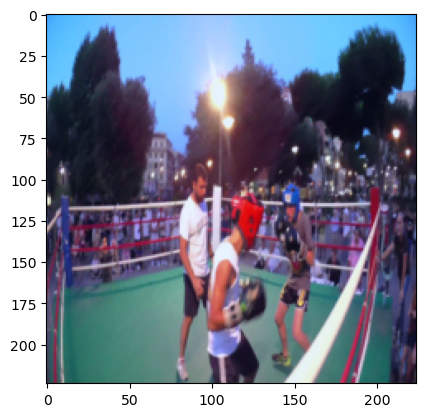

In [7]:
first_img_tensor = img_transforms(Image.open(first_img_path))
plt.imshow(normalize(first_img_tensor).permute(1, 2, 0))

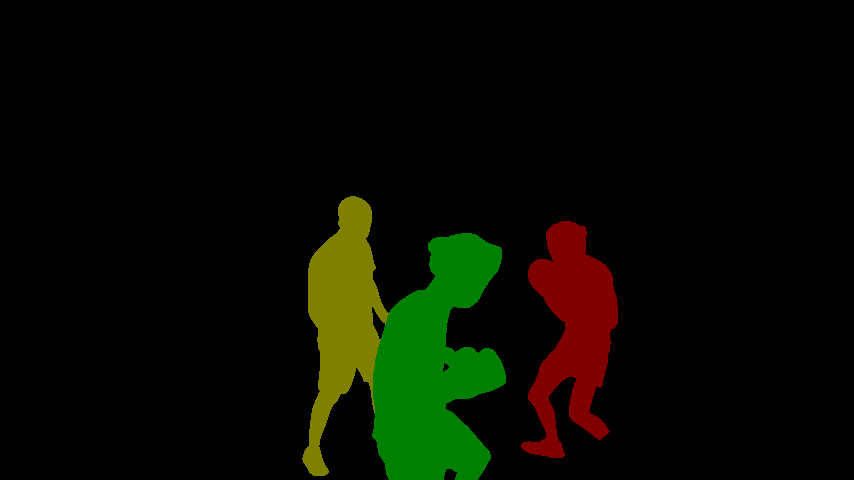

In [8]:
first_anno_path = anno_paths[0]
anno_img = Image.open(first_anno_path).convert("RGB")
anno_img

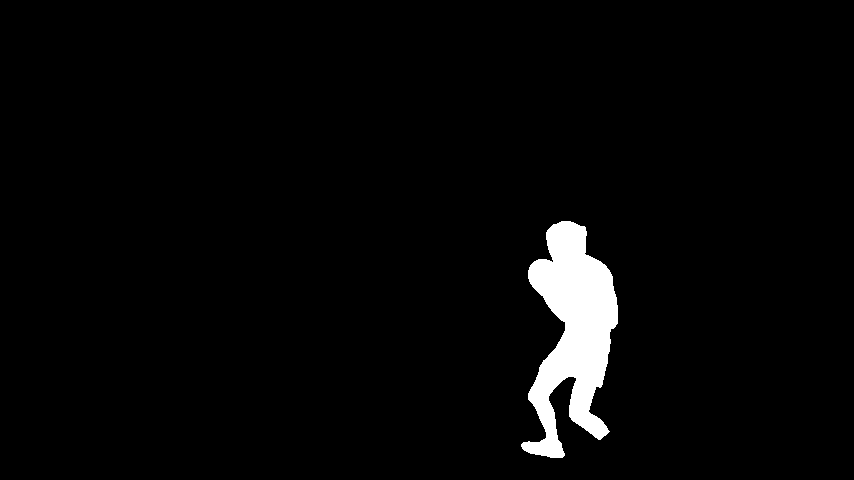

In [9]:
anno_array = np.array(anno_img)
one_anno_array = reserve_color(anno_array, anno_colors[1])
Image.fromarray(one_anno_array)

In [10]:
anno_transform = transforms.Compose(
    [
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
    ]
)

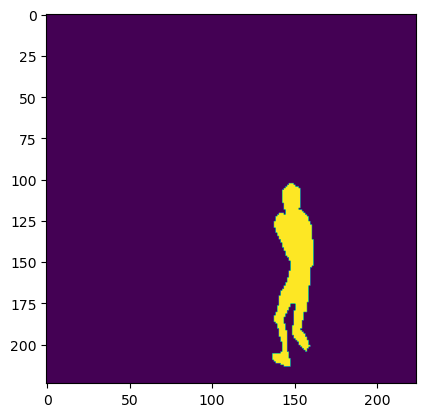

In [11]:
one_anno_tensor = anno_transform(Image.fromarray(one_anno_array))
one_anno_tensor = one_anno_tensor.squeeze(0)
plt.imshow(one_anno_tensor)

In [12]:
class DAVIS_Rawset:
    def __init__(self, is_train=True) -> None:
        if is_train:
            data_type = "train"
        else:
            data_type = "val"
        data_path = f"./2017/{data_type}_video_datas.json"
        video_datas = json.load(open(data_path, "r"))
        self.data_set = []
        img_transforms = transforms.Compose(
            [
                transforms.Resize((224, 224)),
                transforms.ToTensor(),
                transforms.Normalize(
                    mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]
                ),
            ]
        )
        anno_transform = transforms.Compose(
            [
                transforms.Resize((224, 224)),
                transforms.ToTensor(),
            ]
        )
        for video_name, video_data in video_datas.items():
            img_paths = video_data["img_paths"]
            anno_paths = video_data["anno_paths"]
            anno_colors = video_data["anno_colors"]
            for anno_color in anno_colors:
                self.data_set.append([])
                for img_path, anno_path in zip(img_paths, anno_paths):
                    img_tensor = img_transforms(Image.open(img_path))
                    anno_img = Image.open(anno_path).convert("RGB")
                    anno_array = np.array(anno_img)
                    anno_mask = reserve_color(anno_array, anno_color)
                    anno_tensor = anno_transform(Image.fromarray(anno_mask))
                    anno_tensor = anno_tensor.squeeze(0)
                    self.data_set[-1].append((img_tensor, anno_tensor))

    def get_item(self, video_idx, frame_idx):
        return self.data_set[video_idx][frame_idx]

train_set = DAVIS_Rawset(is_train=True)

In [13]:
frame_count = 0
for video_idx in range(len(train_set.data_set)):
    frame_count += len(train_set.data_set[video_idx])
frame_count

10238

In [14]:
class DAVIS_Dataset(Dataset):
    def __init__(self, raw_set: DAVIS_Rawset) -> None:
        super().__init__()
        self.raw_set = raw_set
        self.data = []
        for video_idx, video in enumerate(self.raw_set.data_set):
            for frame_idx in range(len(video) - 1):
                self.data.append(
                    (
                        video_idx,
                        frame_idx,
                        video[0],
                        video[frame_idx],
                        video[frame_idx + 1],
                    )
                )

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        video_idx, frame_idx, fir_frame, pre_frame, cur_frame = self.data[idx]
        fir_img, fir_sgm = fir_frame
        pre_img, pre_sgm = pre_frame
        cur_img, cur_sgm = cur_frame
        return (
            video_idx,
            frame_idx,
            fir_img,
            fir_sgm,
            pre_img,
            pre_sgm,
            cur_img,
            cur_sgm,
        )

In [15]:
train_dataset = DAVIS_Dataset(train_set)
train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True)

In [16]:
(
    video_idx,
    frame_idx,
    fir_img,
    fir_sgm,
    pre_img,
    pre_sgm,
    cur_img,
    cur_sgm,
) = next(iter(train_loader))
fir_img.shape, fir_sgm.shape

(torch.Size([8, 3, 224, 224]), torch.Size([8, 224, 224]))

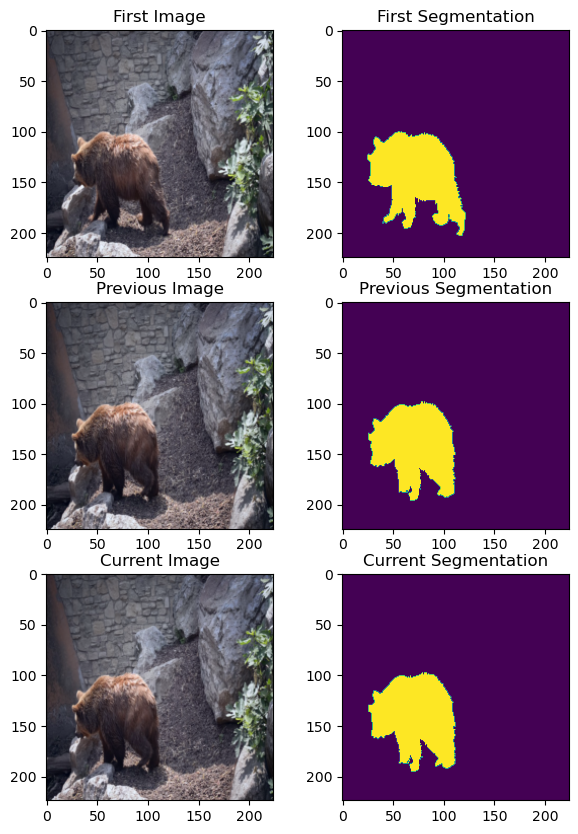

In [17]:
plt.figure(figsize=(7, 10))
# show the first image and its segmentation
plt.subplot(3, 2, 1)
plt.imshow(normalize(fir_img[0]).permute(1, 2, 0))
plt.title("First Image")
plt.subplot(3, 2, 2)
plt.imshow(fir_sgm[0])
plt.title("First Segmentation")
# show the previous image and its segmentation
plt.subplot(3, 2, 3)
plt.imshow(normalize(pre_img[0]).permute(1, 2, 0))
plt.title("Previous Image")
plt.subplot(3, 2, 4)
plt.imshow(pre_sgm[0])
plt.title("Previous Segmentation")
# show the current image and its segmentation
plt.subplot(3, 2, 5)
plt.imshow(normalize(cur_img[0]).permute(1, 2, 0))
plt.title("Current Image")
plt.subplot(3, 2, 6)
plt.imshow(cur_sgm[0])
plt.title("Current Segmentation")
plt.show()

In [18]:
from DETR_model import DinoDetrMaskMul
from polygon import SoftPolygon, RasLoss
import torch.optim as optim
from tqdm import tqdm

In [19]:
solf_polygon = SoftPolygon(0.01, mode="hard_mask").cuda()

In [20]:
model = DinoDetrMaskMul(mul_before=True).cuda()
optimizer = optim.Adam(model.parameters(), lr=1e-4)
ras_loss = RasLoss().cuda()

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main
/work3/s232248/miniconda3/envs/ras/lib/python3.12/site-packages/torch/nn/modules/transformer.py:286: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.self_attn.num_heads is odd
  warnings.warn(f"enable_nested_tensor is True, but self.use_nested_tensor is False because {why_not_sparsity_fast_path}")


In [21]:
# fir_img = fir_img.cuda()
# pre_img = pre_img.cuda()
# cur_img = cur_img.cuda()
# fir_sgm = fir_sgm.cuda()
# pre_sgm = pre_sgm.cuda()
pred_bou = model(
    fir_img.cuda(),
    fir_sgm.cuda(),
    pre_img.cuda(),
    pre_sgm.cuda(),
    cur_img.cuda(),
)
pred_bou.shape

torch.Size([8, 80, 2])

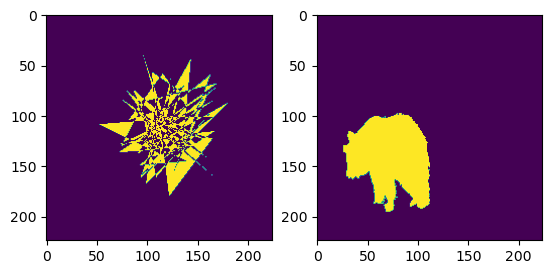

In [22]:
pred_mask = solf_polygon(
    pred_bou.cuda().float(),
    224,
    224,
)
pred_mask.shape
plt.subplot(1, 2, 1)
plt.imshow(pred_mask[0].cpu().detach().numpy())
plt.subplot(1, 2, 2)
plt.imshow(cur_sgm[0].cpu().detach().numpy())

In [23]:
loss_dict = {}
epoch_index = 0
interval_epochs = 5

In [180]:
for interval in range(interval_epochs):
    mean_loss = 0
    model.train()
    for (
        video_idx,
        frame_idx,
        fir_img,
        fir_sgm,
        pre_img,
        pre_sgm,
        cur_img,
        cur_sgm,
    ) in tqdm(train_loader):
        optimizer.zero_grad()
        pred_bou = model(
            fir_img.cuda(),
            fir_sgm.cuda(),
            pre_img.cuda(),
            pre_sgm.cuda(),
            cur_img.cuda(),
        )
        loss = ras_loss(pred_bou, cur_sgm.cuda())
        loss.backward()
        optimizer.step()
        mean_loss += loss.item()
    mean_loss /= len(train_loader)
    loss_dict[epoch_index] = mean_loss
    print(f"Epoch: {epoch_index}, Loss: {mean_loss}")
    epoch_index += 1
    

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1262/1262 [02:22<00:00,  8.84it/s]


Epoch: 5, Loss: 0.3766366368995038


  3%|████▋                                                                                                                                      | 42/1262 [00:04<02:19,  8.72it/s]


KeyboardInterrupt: 

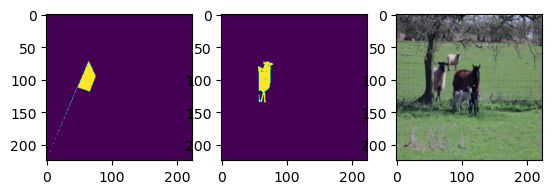

In [179]:
(
    video_idx,
    frame_idx,
    fir_img,
    fir_sgm,
    pre_img,
    pre_sgm,
    cur_img,
    cur_sgm,
) = next(iter(train_loader))
pred_bou = model(
    fir_img.cuda(),
    fir_sgm.cuda(),
    pre_img.cuda(),
    pre_sgm.cuda(),
    cur_img.cuda(),
)
pred_mask = solf_polygon(
    pred_bou.cuda().float(),
    224,
    224,
)
pred_mask.shape
plt.subplot(1, 3, 1)
plt.imshow(pred_mask[0].cpu().detach().numpy())
plt.subplot(1, 3, 2)
plt.imshow(cur_sgm[0].cpu().detach().numpy())
plt.subplot(1, 3, 3)
plt.imshow(normalize(cur_img[0].permute(1, 2, 0).cpu().detach().numpy()))


In [128]:
from preprocess_utensils import get_boundary_iou
import cv2 as cv

In [237]:
def get_boundary_iou(image: np.array, boundary: np.ndarray) -> float:
    """
    Get the IOU of the boundary with the image.
    """
    mask = np.zeros(image.shape[:2], dtype=np.uint8)
    mask = cv.fillPoly(mask, [boundary.astype(np.int32)], 1)
    intersection = np.logical_and(image, mask)
    union = np.logical_or(image, mask)
    if image.sum() == 0:
        # print("image is empty")
        return 1
    return intersection.sum() / union.sum()

In [154]:
get_boundary_iou(
    cur_sgm[0].cpu().detach().numpy(),
    pred_bou[0].cpu().detach().numpy(),
)

0.45134485020774107

In [221]:
def infer_video(
    raw_set: DAVIS_Rawset,
    model: torch.nn.Module,
    hard_polygon: SoftPolygon,
    video_idx: int,
):
    infer_results = []
    model.eval()
    fir_img, fir_sgm = raw_set.data_set[video_idx][0]
    infer_results.append(None)
    pre_img, pre_sgm = raw_set.data_set[video_idx][0]
    with torch.no_grad():
        for frame_idx in range(1, len(raw_set.data_set[video_idx])):
            cur_img, cur_sgm = raw_set.data_set[video_idx][frame_idx]
            pred_bou = model(
                fir_img.unsqueeze(0).cuda(),
                fir_sgm.unsqueeze(0).cuda(),
                pre_img.unsqueeze(0).cuda(),
                pre_sgm.unsqueeze(0).cuda(),
                cur_img.unsqueeze(0).cuda(),
            )
            pred_mask = hard_polygon(
                pred_bou.cuda().float(),
                224,
                224,
            )
            infer_results.append(pred_bou.squeeze(0).cpu().detach().numpy())
            pre_img, pre_sgm = cur_img, pred_mask.squeeze(0)
            # pre_img, pre_sgm = cur_img, cur_sgm.squeeze(0)
    return infer_results
index = 5
infer_results = infer_video(train_set, model, solf_polygon, index)
infer_results

[None,
 array([[  0.27209914, 223.33295   ],
        [  0.28456956, 223.39285   ],
        [  0.26057225, 223.3031    ],
        [  0.2705928 , 223.31044   ],
        [  0.2571034 , 223.29544   ],
        [  0.26801264, 223.33455   ],
        [  0.27020338, 223.35674   ],
        [  0.2537173 , 223.26152   ],
        [  0.26402265, 223.30673   ],
        [  0.2596896 , 223.2821    ],
        [  0.28399837, 223.39949   ],
        [  0.27340132, 223.36008   ],
        [  0.26249886, 223.30052   ],
        [  0.26749122, 223.33305   ],
        [  0.27284527, 223.38684   ],
        [  0.29673898, 223.4416    ],
        [  0.25145498, 223.2268    ],
        [  0.27552214, 223.36902   ],
        [  0.26158047, 223.2886    ],
        [  0.26198563, 223.29675   ],
        [  0.27738276, 223.3978    ],
        [  0.263683  , 223.32712   ],
        [  0.25997943, 223.3031    ],
        [  0.27203655, 223.32916   ],
        [  0.26767206, 223.3446    ],
        [  0.2820056 , 223.40013   ],
     

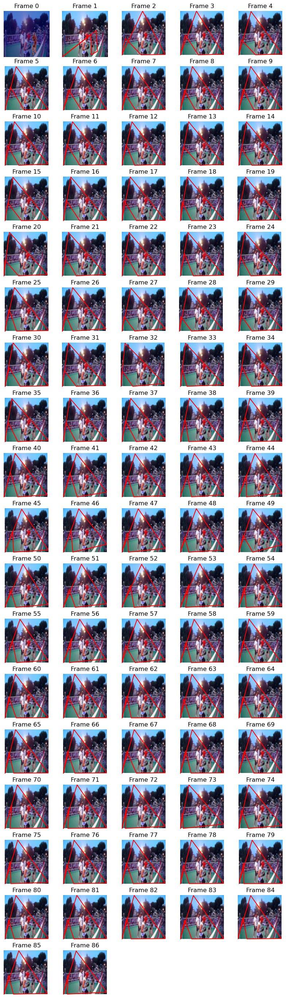

In [222]:
def show_infer_results(
    raw_set: DAVIS_Dataset,
    video_idx: int,
    infer_results: list,
    figsize=(10, 35),
):
    fir_img, fir_sgm = raw_set.data_set[video_idx][0]
    plot_height = len(infer_results) // 5 + 1

    plt.figure(figsize=figsize)
    plt.subplot(plot_height, 5, 1)
    plt.imshow(normalize(fir_img).permute(1, 2, 0))
    plt.imshow(fir_sgm, alpha=0.4, cmap="jet")
    plt.title(f"Frame {0}")
    plt.axis("off")
    for frame_idx in range(1, len(infer_results)):
        plt.subplot(plot_height, 5, frame_idx + 1)
        plt.imshow(normalize(fir_img).permute(1, 2, 0))
        infer_bou = infer_results[frame_idx]
        plt.plot(infer_bou[:, 0], infer_bou[:, 1], "r")
        plt.axis("off")
        plt.title(f"Frame {frame_idx}")
    plt.show()
show_infer_results(train_set, index, infer_results)

In [232]:
def get_video_iou(
    raw_set: DAVIS_Rawset,
    infer_results: list,
    video_idx: int,
) -> float:
    total_iou = 1
    for frame_idx in range(1, len(raw_set.data_set[video_idx])):
        cur_img, cur_sgm = raw_set.data_set[video_idx][frame_idx]
        iou = get_boundary_iou(
            cur_sgm.cpu().detach().numpy(),
            infer_results[frame_idx],
        )
        print(f"Frame {frame_idx} IOU: {iou}")
        total_iou += iou

        
    return total_iou / len(raw_set.data_set[video_idx])
get_video_iou(train_set, infer_results, index)

Frame 1 IOU: 0.44704779756326146
Frame 2 IOU: 0.06783223037023788
Frame 3 IOU: 0.06477093206951026
Frame 4 IOU: 0.0501675189560924
Frame 5 IOU: 0.051613230005571595
Frame 6 IOU: 0.058742975870047696
Frame 7 IOU: 0.05377199964623684
Frame 8 IOU: 0.05744246473645137
Frame 9 IOU: 0.06432077808872781
Frame 10 IOU: 0.06059657439291624
Frame 11 IOU: 0.05898569323637055
Frame 12 IOU: 0.05440331110600138
Frame 13 IOU: 0.06121760909353627
Frame 14 IOU: 0.061825670412320365
Frame 15 IOU: 0.06857803468208093
Frame 16 IOU: 0.06669157481785914
Frame 17 IOU: 0.06434038721296713
Frame 18 IOU: 0.059457820890351634
Frame 19 IOU: 0.06298057691452953
Frame 20 IOU: 0.061450786358013786
Frame 21 IOU: 0.06140634378318482
Frame 22 IOU: 0.06842535197731969
Frame 23 IOU: 0.06725663716814159
Frame 24 IOU: 0.06969161798668659
Frame 25 IOU: 0.07058402006449302
Frame 26 IOU: 0.06609084267973013
Frame 27 IOU: 0.0605260842790534
Frame 28 IOU: 0.056451612903225805
Frame 29 IOU: 0.058529905468680976
Frame 30 IOU: 0.05

0.07739315292397127

In [235]:
class DAVIS_Infer:
    def __init__(self, raw_set: DAVIS_Rawset) -> None:
        self.raw_set = raw_set
        self.hard_polygon = SoftPolygon(0.01, mode="hard_mask").cuda()
        self.total_results = []

    def infer_video(self, model: torch.nn.Module, video_idx: int):
        infer_results = []
        model.eval()
        fir_img, fir_sgm = self.raw_set.data_set[video_idx][0]
        infer_results.append(None)
        pre_img, pre_sgm = self.raw_set.data_set[video_idx][0]
        with torch.no_grad():
            for frame_idx in range(1, len(self.raw_set.data_set[video_idx])):
                cur_img, cur_sgm = self.raw_set.data_set[video_idx][frame_idx]
                pred_bou = model(
                    fir_img.unsqueeze(0).cuda(),
                    fir_sgm.unsqueeze(0).cuda(),
                    pre_img.unsqueeze(0).cuda(),
                    pre_sgm.unsqueeze(0).cuda(),
                    cur_img.unsqueeze(0).cuda(),
                )
                pred_mask = self.hard_polygon(
                    pred_bou.cuda().float(),
                    224,
                    224,
                )
                infer_results.append(pred_bou.squeeze(0).cpu().detach().numpy())
                pre_img, pre_sgm = cur_img, pred_mask.squeeze(0)
        return infer_results
    
    def infer_model(self, model: torch.nn.Module):
        for video_idx in tqdm(range(len(self.raw_set.data_set))):
            infer_results = self.infer_video(model, video_idx)
            self.total_results.append(infer_results)
        return self.total_results
    
    def get_video_iou(self, video_idx: int) -> float:
        total_iou = 1
        for frame_idx in range(1, len(self.raw_set.data_set[video_idx])):
            cur_img, cur_sgm = self.raw_set.data_set[video_idx][frame_idx]
            iou = get_boundary_iou(
                cur_sgm.cpu().detach().numpy(),
                self.total_results[video_idx][frame_idx],
            )
            # print(f"Frame {frame_idx} IOU: {iou}")
            total_iou += iou
        return total_iou / len(self.raw_set.data_set[video_idx])
    
    def get_total_iou(self) -> float:
        total_iou = 0
        for video_idx in range(len(self.raw_set.data_set)):
            total_iou += self.get_video_iou(video_idx)
        return total_iou / len(self.raw_set.data_set)
    
    def show_infer_results(self, video_idx: int, figsize=(10, 35)):
        infer_results = self.total_results[video_idx]
        raw_set = self.raw_set
        fir_img, fir_sgm = raw_set.data_set[video_idx][0]
        plot_height = len(infer_results) // 5 + 1

        plt.figure(figsize=figsize)
        plt.subplot(plot_height, 5, 1)
        plt.imshow(normalize(fir_img).permute(1, 2, 0))
        plt.imshow(fir_sgm, alpha=0.4, cmap="jet")
        plt.title(f"Frame {0}")
        plt.axis("off")
        for frame_idx in range(1, len(infer_results)):
            plt.subplot(plot_height, 5, frame_idx + 1)
            plt.imshow(normalize(fir_img).permute(1, 2, 0))
            infer_bou = infer_results[frame_idx]
            plt.plot(infer_bou[:, 0], infer_bou[:, 1], "r")
            plt.axis("off")
            plt.title(f"Frame {frame_idx}")
        plt.show()

infer = DAVIS_Infer(train_set)
infer.infer_model(model)
    

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 144/144 [04:25<00:00,  1.84s/it]


[[None,
  array([[  0.26794   , 223.29704   ],
         [  0.26858816, 223.31697   ],
         [  0.2502232 , 223.23058   ],
         [  0.2670737 , 223.24554   ],
         [  0.25754413, 223.2603    ],
         [  0.25891736, 223.27055   ],
         [  0.2691812 , 223.3132    ],
         [  0.25177783, 223.2164    ],
         [  0.25772294, 223.26056   ],
         [  0.2578764 , 223.25168   ],
         [  0.26453295, 223.33197   ],
         [  0.26648805, 223.3201    ],
         [  0.25690928, 223.2511    ],
         [  0.26284602, 223.28271   ],
         [  0.26187962, 223.31769   ],
         [  0.27222136, 223.35767   ],
         [  0.24669297, 223.16362   ],
         [  0.26693454, 223.3282    ],
         [  0.25301677, 223.21693   ],
         [  0.25709754, 223.24811   ],
         [  0.27186856, 223.34676   ],
         [  0.25570646, 223.27917   ],
         [  0.24376851, 223.19458   ],
         [  0.2562275 , 223.22867   ],
         [  0.25609088, 223.26721   ],
         [  0.262

In [238]:
infer.get_total_iou()

0.16627249464753444